In [ ]:
%cd /content

/content


# *Hi, THE FOLLOWING STEPS ARE DONE TO EXPLORE DATA AND CREATE TRAIN AND TEST DATA*

In [1]:
from tqdm import tqdm
from nltk.translate.bleu_score import sentence_bleu,corpus_bleu
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


In [2]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('/content/resnet_gru')

**Hi, don't forget to first upload the data on your own drive, and make sure there are no restrictions involved through drive.**

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:

!unzip /content/drive/MyDrive/Filckr8k.zip

Streaming output truncated to the last 5000 lines.
  inflating: Filckr8k/Images/2844846111_8c1cbfc75d.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2844846111_8c1cbfc75d.jpg  
  inflating: Filckr8k/Images/1082252566_8c79beef93.jpg  
  inflating: __MACOSX/Filckr8k/Images/._1082252566_8c79beef93.jpg  
  inflating: Filckr8k/Images/1386251841_5f384a0fea.jpg  
  inflating: __MACOSX/Filckr8k/Images/._1386251841_5f384a0fea.jpg  
  inflating: Filckr8k/Images/2196316998_3b2d63f01f.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2196316998_3b2d63f01f.jpg  
  inflating: Filckr8k/Images/3106791484_13e18c33d8.jpg  
  inflating: __MACOSX/Filckr8k/Images/._3106791484_13e18c33d8.jpg  
  inflating: Filckr8k/Images/3603064161_a8f3b6455d.jpg  
  inflating: __MACOSX/Filckr8k/Images/._3603064161_a8f3b6455d.jpg  
  inflating: Filckr8k/Images/2293149170_38fb2257ea.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2293149170_38fb2257ea.jpg  
  inflating: Filckr8k/Images/2451114871_8617ae2f16.jpg  
  inflating: __MA

In [5]:
image_data_location = "/content/Filckr8k/Images"
caption_data_location = "/content/Filckr8k/captions_images.txt"

In [6]:
df = pd.read_csv(caption_data_location)

In [7]:
df.head()

,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40455 entries, 0 to 40454
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   image    40455 non-null  object
 1   caption  40455 non-null  object
dtypes: object(2)
memory usage: 632.2+ KB


In [9]:
train_data_df = df.iloc[:40000,:]
test_data_df = df.iloc[40000:,:]

In [10]:
train_data_df.tail()

,image,caption
39995,887108308_2da97f15ef.jpg,A child walks while holding an adult 's hand .
39996,887108308_2da97f15ef.jpg,A man holds a child 's hand as they walk .
39997,887108308_2da97f15ef.jpg,A woman walks hand-in-hand with a little boy w...
39998,887108308_2da97f15ef.jpg,A young boy has his hand in the back of his pa...
39999,887108308_2da97f15ef.jpg,The man is walking with a young child outside .


In [11]:
test_data_df.head()

,image,caption
40000,888425986_e4b6c12324.jpg,A boy is upside down in midair near a lake at ...
40001,888425986_e4b6c12324.jpg,A person does a flip by two sailboats and a la...
40002,888425986_e4b6c12324.jpg,A person flipping upside down
40003,888425986_e4b6c12324.jpg,a person in midair doing a back flip .
40004,888425986_e4b6c12324.jpg,A person is doing a flip in midair near a lake...


In [12]:
train_data_df.to_csv('train_captions.txt',index = False)
test_data_df.to_csv('test_captions.txt', index = False)

In [13]:
train_data_location = '/content/train_captions.txt'
test_data_location = '/content/test_captions.txt'

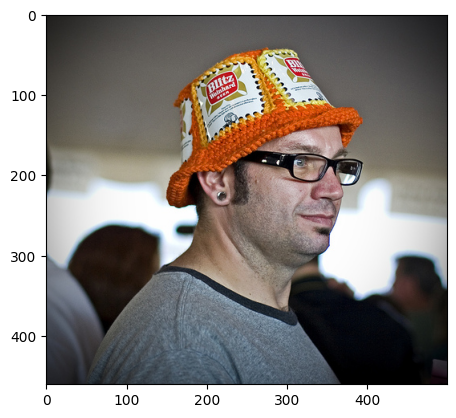

Caption - A man in an orange hat starring at something .
Caption - A man wears an orange hat and glasses .
Caption - A man with gauges and glasses is wearing a Blitz hat .
Caption - A man with glasses is wearing a beer can crocheted hat .
Caption - The man with pierced ears is wearing glasses and an orange hat .


In [15]:
data_idx = 20
image_path = image_data_location + "/" + df.iloc[data_idx,0]
# print( df.iloc[data_idx,:])
img = mpimg.imread(image_path)
plt.imshow(img)
plt.show()

for i in range(data_idx, data_idx+5):
    print(f"Caption - {df.iloc[i,1]}")

In [16]:
import os
from collections import Counter
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as T

In [17]:
spacy_eng = spacy.load('en_core_web_sm')
text = "This is a good place to find a city"
[token.text.lower() for token in spacy_eng.tokenizer(text)]

['this', 'is', 'a', 'good', 'place', 'to', 'find', 'a', 'city']

# Creating the vacabulary class 

This class creates the actual mapping of the words to its integer and vice-versa. This helps in assiging a numerical value to a word, that can be easily processed by the model.

This class also keeps track of the different words in the "vocabulary" of the model.

In [18]:
class Vocabulary:
    def __init__(self,freq_threshold):
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        self.stoi = {v:k for k,v in self.itos.items()}
        self.freq_threshold = freq_threshold
    
    def __len__(self):
        return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocab(self,sentence_list):
        frequencies = Counter()
        idx = 4
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        tokenized_text = self.tokenize(text)
        return [self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text]
                
                

In [19]:
v = Vocabulary(freq_threshold=1)
v.build_vocab(["This is a new city"])
print(v.stoi)
print(v.numericalize("This is a new city"))

{'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, 'this': 4, 'is': 5, 'a': 6, 'new': 7, 'city': 8}
[4, 5, 6, 7, 8]


In [20]:
df = pd.read_csv(caption_data_location)
print(df["image"][0][::-1])

gpj.e0bc80b396_1028620001


In [21]:
class CustomDataset(Dataset):
    def __init__(self,root_dir,captions_file,transform=None, freq_threshold=5):
        self.root_dir = root_dir
        self.df = pd.read_csv(captions_file)
        
        self.transform = transform
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]
        
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")
        
        if self.transform is not None:
            img = self.transform(img)
            
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        return img, torch.tensor(caption_vec)

In [22]:
#defing the transform to be applied
transforms = T.Compose([
    T.Resize((224,224)),
    T.ToTensor()
])

In [23]:
def show_image(inp, title=None):
    """Imshow for Tensor"""
    inp = inp.numpy().transpose((1,2,0))
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

In [24]:
# testing the dataset
dataset = CustomDataset(
        root_dir = image_data_location,
        captions_file = train_data_location,
        transform = transforms
)

In [25]:
print(len(dataset))

40000


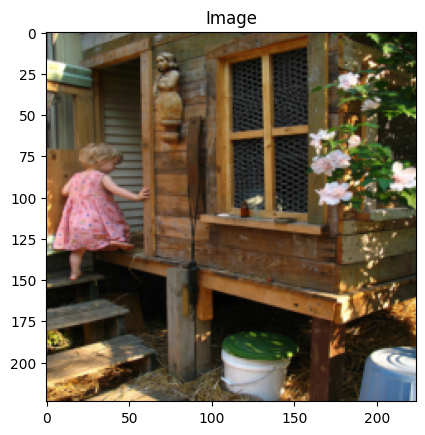

Token : tensor([  1,   4,   7, 316,  76,   4, 157,  74,   5,   2])
Sentence: 
['<SOS>', 'a', 'girl', 'going', 'into', 'a', 'wooden', 'building', '.', '<EOS>']


In [26]:
img, caps = dataset[1]
# print(caps)
show_image(img,"Image")
print("Token :",caps)
print("Sentence: ")
print([dataset.vocab.itos[token] for token in caps.tolist()])

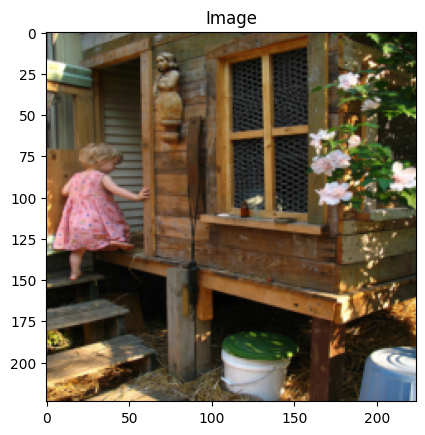

Token : tensor([  1,   4,  28,   8,   4, 195, 151,  17,  32,  67,   4, 353,  11, 711,
          8,  24,   3, 496,   5,   2])
Sentence: 
['<SOS>', 'a', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', '<UNK>', 'way', '.', '<EOS>']


In [27]:
img, caps = dataset[0]
show_image(img,"Image")
print("Token :",caps)
print("Sentence: ")
print([dataset.vocab.itos[token] for token in caps.tolist()])

In [28]:
class CapsCollate:
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
        
    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
#         print(f"shape - {(imgs)}")
#         print("----"*22)
        imgs = torch.cat(imgs,dim=0)
#         print(f"shape - {imgs}")
#         print("------")
        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        return imgs,targets

In [29]:
#writing the dataloader
#setting the constants
BATCH_SIZE = 4
NUM_WORKER = 1

#token to represent the padding
pad_idx = dataset.vocab.stoi["<PAD>"]

data_loader = DataLoader(
    dataset=dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
    collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True)
)

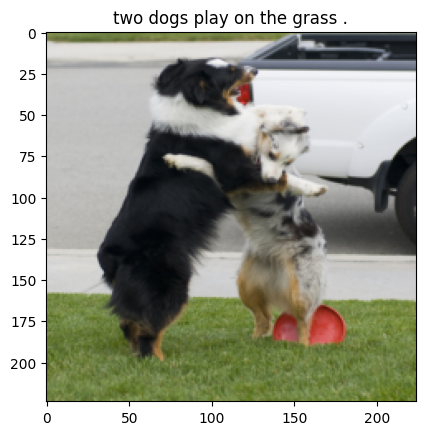

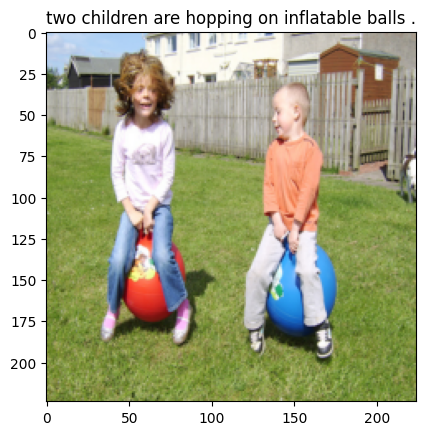

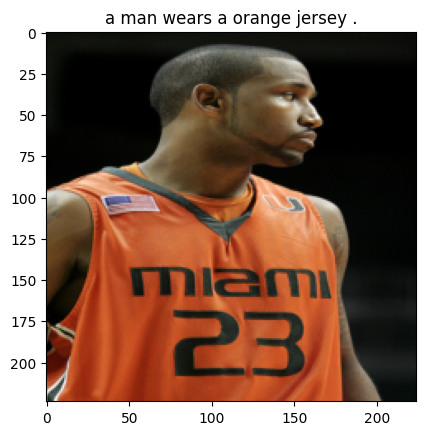

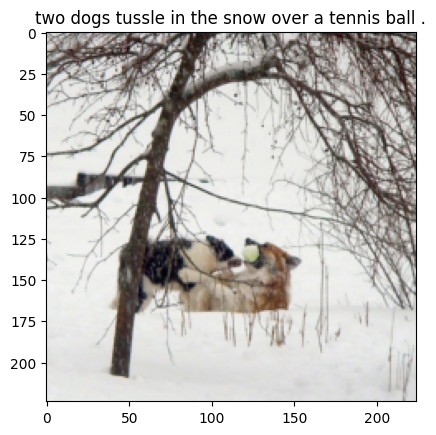

In [30]:
#generating the iterator from the dataloader
dataiter = iter(data_loader)

#getting the next batch
batch = next(dataiter)

#unpacking the batch
images, captions = batch

#showing info of image in single batch
for i in range(BATCH_SIZE):
    img,cap = images[i],captions[i]
#     print(f"captions - {captions[i]}")
    caption_label = [dataset.vocab.itos[token] for token in cap.tolist()]
    eos_index = caption_label.index('<EOS>')
    caption_label = caption_label[1:eos_index]
    caption_label = ' '.join(caption_label)                      
    show_image(img,caption_label)
    plt.show()

In [31]:
import torch
import torch.nn as nn
import torchvision.models as models
import torch.optim as optim

# ENCODERCNN class 

This class is where the feature extraction model is there. We utilized two feature extractors: **VGG16 **and **resnet50**. There are several others that can also be used. Care must be taken to ensure the output and the input given to the instance of this class as that may cause the feature extractor to either work properly or raise errors. 

Here we are using the resnet50 pretrained model.

# DECODER-RNN class

This class takes in feature extracted by the feature extractor and the captions and returns the outputs. It includes a generate captions function that return the predictd caption of the model.

Here we are using GRU layer.

In [32]:
class EncoderCNN(nn.Module):
    def __init__(self,embed_size):
        super(EncoderCNN,self).__init__()
        resnet = models.resnet50(pretrained=True)
        for param in resnet.parameters():
            param.requires_grad_(False)
        
        modules = list(resnet.children())[:-1]
        self.resnet = nn.Sequential(*modules)
        self.embed = nn.Linear(resnet.fc.in_features,embed_size)
        
    def forward(self,images):
        features = self.resnet(images)
#         print(f"resenet features shape - {features.shape}")
        features = features.view(features.size(0),-1)
#         print(f"resenet features viewed shape - {features.shape}")
        features = self.embed(features)
#         print(f"resenet features embed shape - {features.shape}")
        return features

class DecoderRNN(nn.Module):
    def __init__(self,embed_size,hidden_size,vocab_size,num_layers=1,drop_prob=0.3):
        super(DecoderRNN,self).__init__()
        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.gru = nn.GRU(embed_size,hidden_size,num_layers=num_layers,batch_first=True)
        self.fcn = nn.Linear(hidden_size,vocab_size)
        self.drop = nn.Dropout(drop_prob)
    
    def forward(self,features, captions):
        # vectorize the caption
#         print(f"captions - {captions[:,:-1]}")
#         print(f"caption shape - {captions[:,:-1].shape}")
        embeds = self.embedding(captions[:,:-1])
#         print(f"shape of embeds - {embeds.shape}")
        # concat the features and captions
#         print(f"features shape - {features.shape}")
#         print(f"features unsqueeze at index 1 shape - {features.unsqueeze(1).shape}")
        x = torch.cat((features.unsqueeze(1),embeds),dim=1)
#         print(f"shape of x - {x.shape}")
        x,_ = self.gru(x)
#         print(f"shape of x after lstm - {x.shape}")
        x = self.fcn(x)
#         print(f"shape of x after fcn - {x.shape}")
        return x
    
    def generate_caption(self,inputs,hidden=None,max_len=20,vocab=None):
        # Inference part
        # Given the image features generate the captions
        
        batch_size = inputs.size(0)
        
        captions = []
        
        for i in range(max_len):
            output,hidden = self.gru(inputs,hidden)
            output = self.fcn(output)
            output = output.view(batch_size,-1)
        
            
            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)
            
            #save the generated word
            captions.append(predicted_word_idx.item())
            
            #end if <EOS detected>
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            
            #send generated word as the next caption
            inputs = self.embedding(predicted_word_idx.unsqueeze(0))
        
        #covert the vocab idx to words and return sentence
        return [vocab.itos[idx] for idx in captions]


class EncoderDecoder(nn.Module):
    def __init__(self,embed_size,hidden_size,vocab_size,num_layers=1,drop_prob=0.3):
        super(EncoderDecoder,self).__init__()
        self.encoder = EncoderCNN(embed_size)
        self.decoder = DecoderRNN(embed_size,hidden_size,vocab_size,num_layers,drop_prob)
    
    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs
# resenet features shape - torch.Size([4, 2048, 1, 1])
# resenet features viewed shape - torch.Size([4, 2048])
# resenet features embed shape - torch.Size([4, 400])
# caption shape - torch.Size([4, 14])
# shape of embeds - torch.Size([4, 14, 400])
# features shape - torch.Size([4, 400])
# features unsqueeze at index 1 shape - torch.Size([4, 1, 400])
# shape of x - torch.Size([4, 15, 400])
# shape of x after lstm - torch.Size([4, 15, 512])
# shape of x after fcn - torch.Size([4, 15, 2994])

In [33]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [34]:
# Hyperparameters
embed_size = 400
hidden_size = 512
vocab_size = len(dataset.vocab)
num_layers = 2
learning_rate = 0.0001
num_epochs = 2

In [35]:
# initialize model, loss etc
model = EncoderDecoder(embed_size, hidden_size, vocab_size, num_layers).to(device)
criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 295MB/s]


# Model Training

Epoch: 1 loss: 3.11200 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog is running through the water . <EOS>


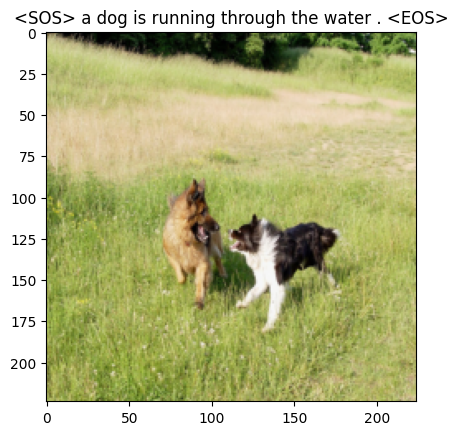

Epoch: 1 loss: 2.35452 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man is standing on a swing . <EOS>


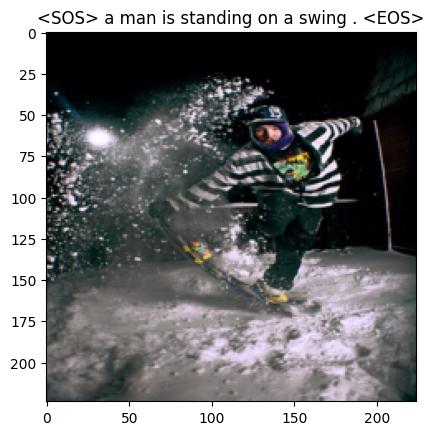

Epoch: 2 loss: 2.63450 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt is standing on a rock overlooking a lake . <EOS>


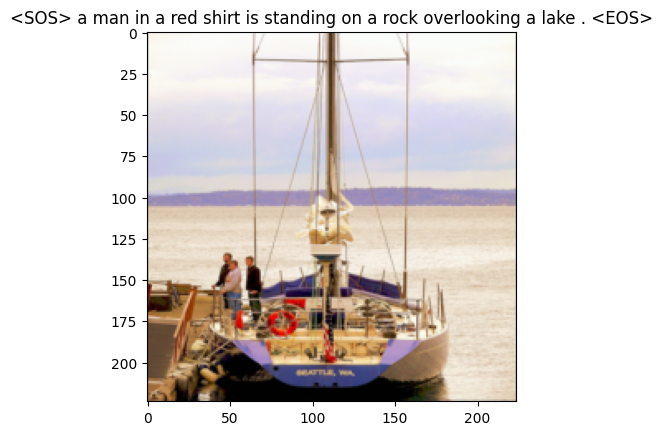

Epoch: 2 loss: 2.11761 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt is jumping into a pool . <EOS>


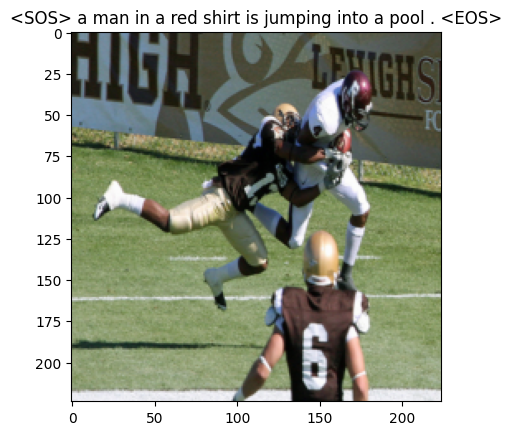

Epoch: 3 loss: 2.05788 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog is running through a field . <EOS>


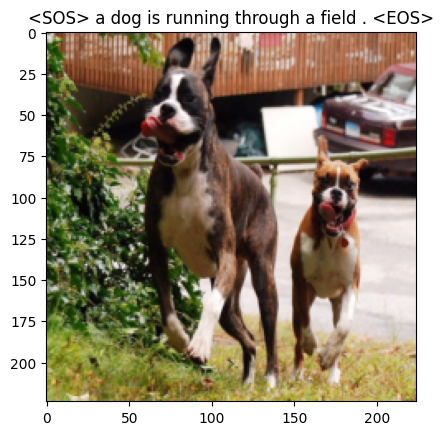

Epoch: 3 loss: 2.15479 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a white shirt and black shorts is running on a field . <EOS>


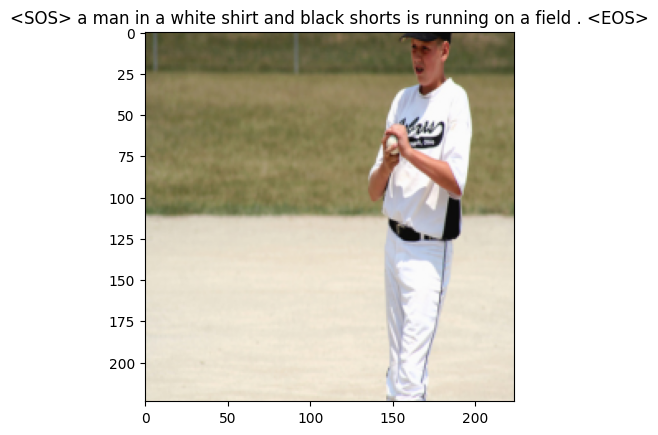

Epoch: 4 loss: 2.38806 iter:4000
features shape - torch.Size([1, 400])
<SOS> a black dog is running through the water . <EOS>


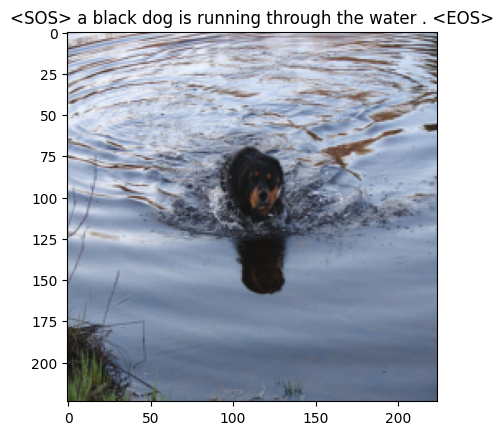

Epoch: 4 loss: 2.57291 iter:8000
features shape - torch.Size([1, 400])
<SOS> a football player in red and white is running with the ball . <EOS>


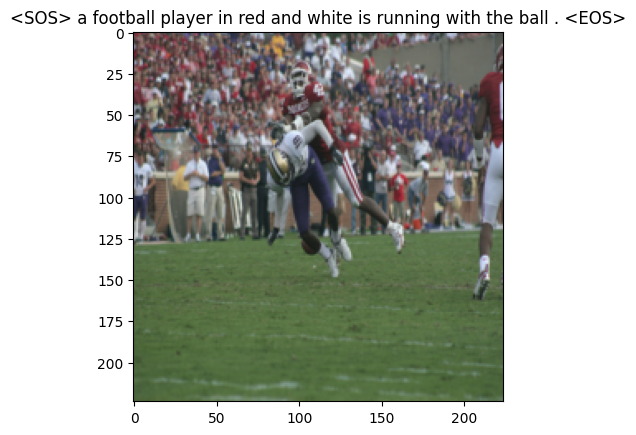

Epoch: 5 loss: 1.90408 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt is standing in front of a white building . <EOS>


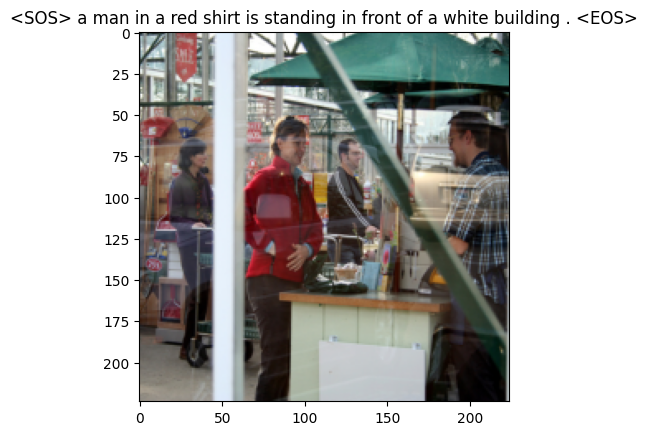

Epoch: 5 loss: 1.74032 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a black jacket and a white shirt is standing on a sidewalk . <EOS>


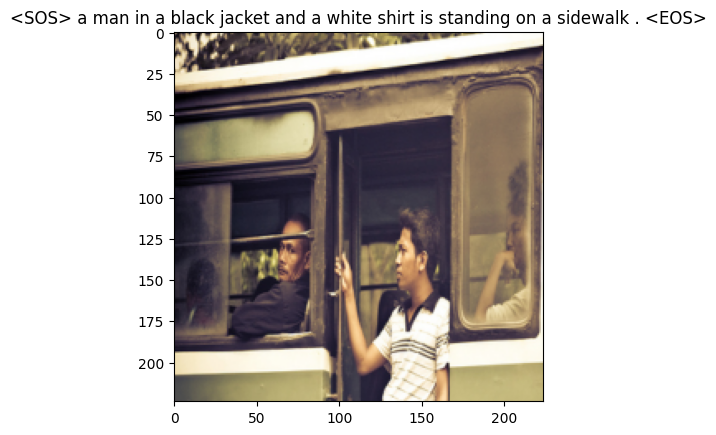

Epoch: 6 loss: 1.99392 iter:4000
features shape - torch.Size([1, 400])
<SOS> a tennis player in a red uniform is running with the ball . <EOS>


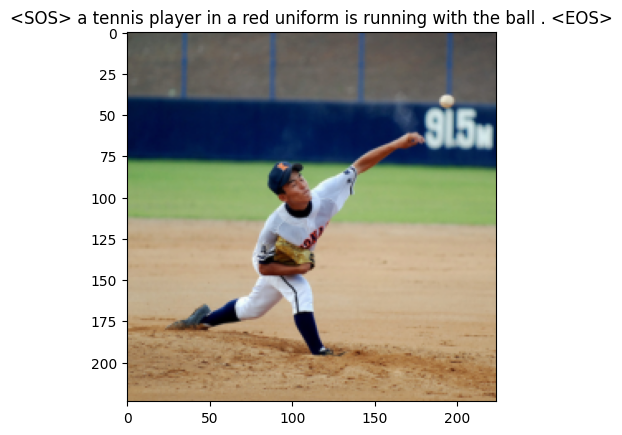

Epoch: 6 loss: 1.83306 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a red jacket is standing in front of a <UNK> . <EOS>


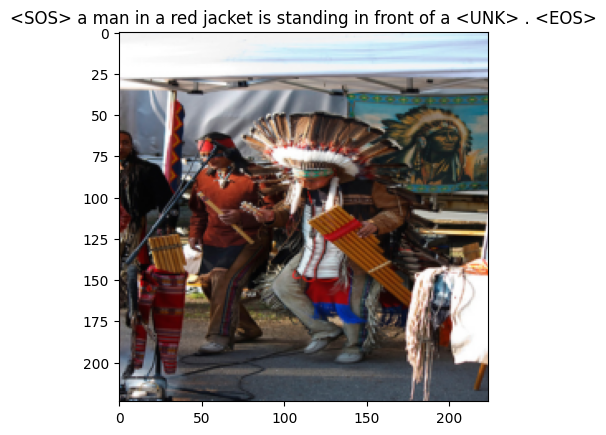

Epoch: 7 loss: 2.19762 iter:4000
features shape - torch.Size([1, 400])
<SOS> a brown dog is running through a large puddle . <EOS>


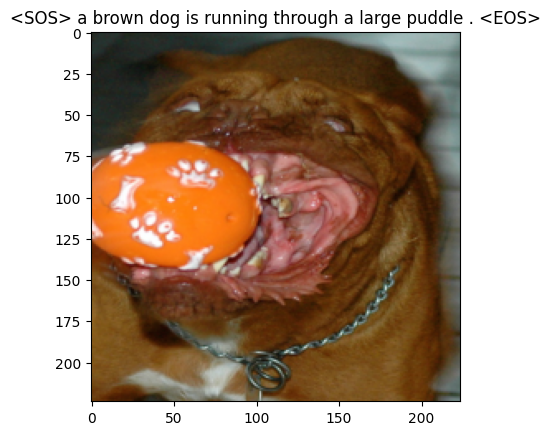

Epoch: 7 loss: 1.98882 iter:8000
features shape - torch.Size([1, 400])
<SOS> a boy in a blue shirt is sitting on a red couch . <EOS>


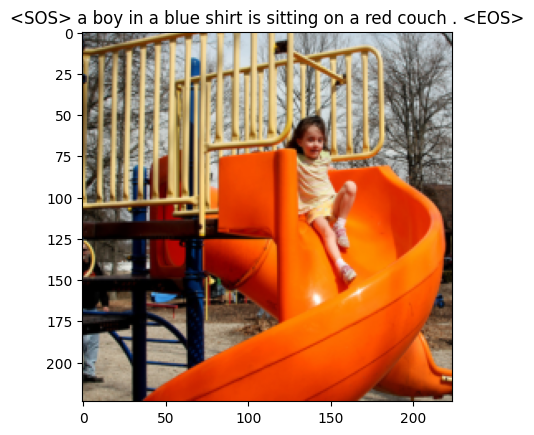

Epoch: 8 loss: 1.46567 iter:4000
features shape - torch.Size([1, 400])
<SOS> two boys are playing with a soccer ball on a trampoline . <EOS>


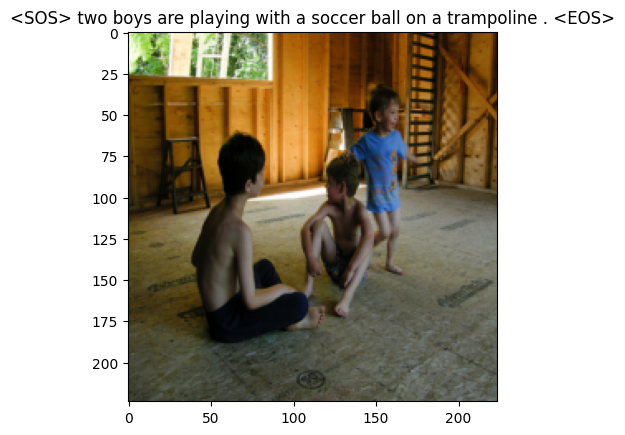

Epoch: 8 loss: 1.46374 iter:8000
features shape - torch.Size([1, 400])
<SOS> a group of dogs are running on a beach . <EOS>


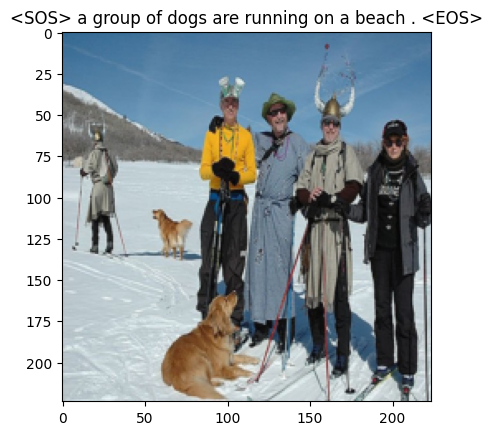

Epoch: 9 loss: 2.01230 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a wetsuit is surfing . <EOS>


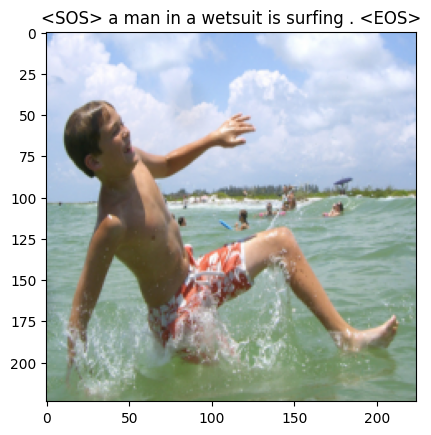

Epoch: 9 loss: 1.84863 iter:8000
features shape - torch.Size([1, 400])
<SOS> a surfer is riding a wave . <EOS>


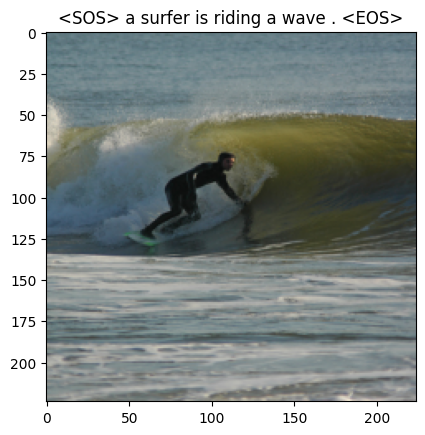

Epoch: 10 loss: 1.71744 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog is running through the water . <EOS>


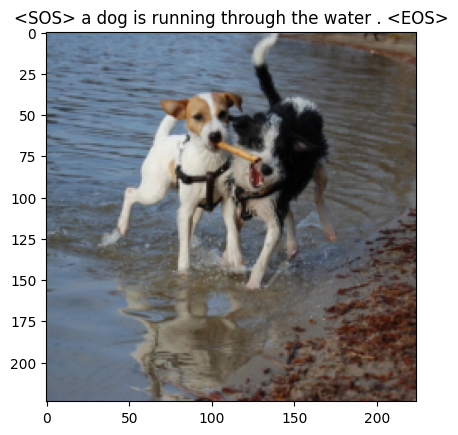

Epoch: 10 loss: 1.45686 iter:8000
features shape - torch.Size([1, 400])
<SOS> a black and white dog is running through a grassy area . <EOS>


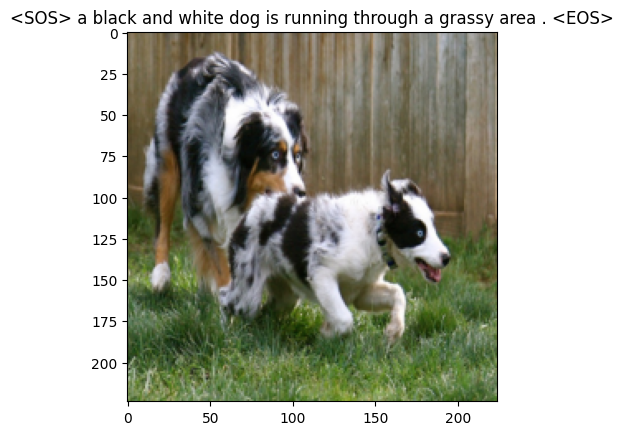

Epoch: 11 loss: 1.88754 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man on a motorcycle is performing a trick in the air . <EOS>


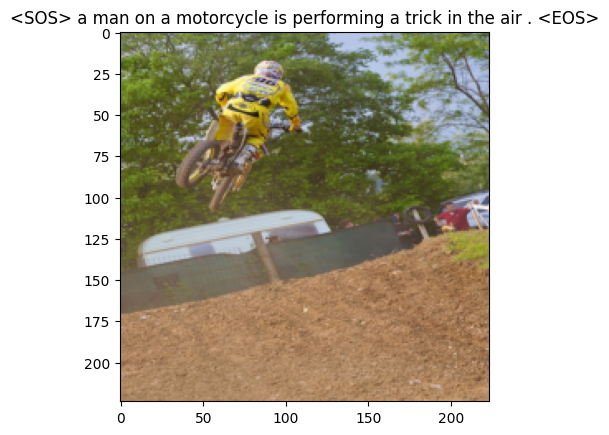

Epoch: 11 loss: 1.45984 iter:8000
features shape - torch.Size([1, 400])
<SOS> a woman in a white shirt and a woman in a black dress dancing . <EOS>


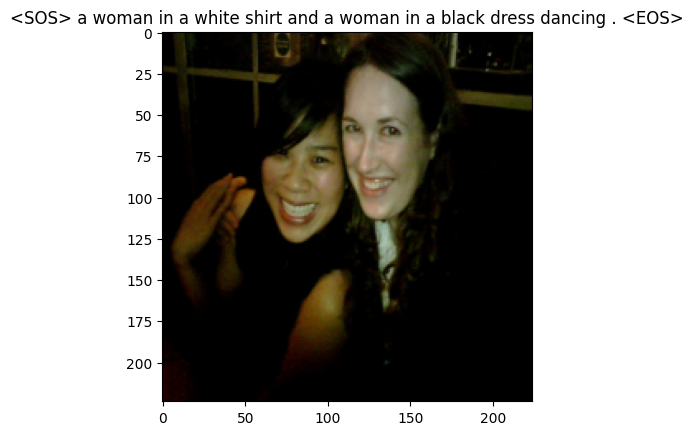

Epoch: 12 loss: 1.72303 iter:4000
features shape - torch.Size([1, 400])
<SOS> a young boy is playing with a soccer ball in a grassy field . <EOS>


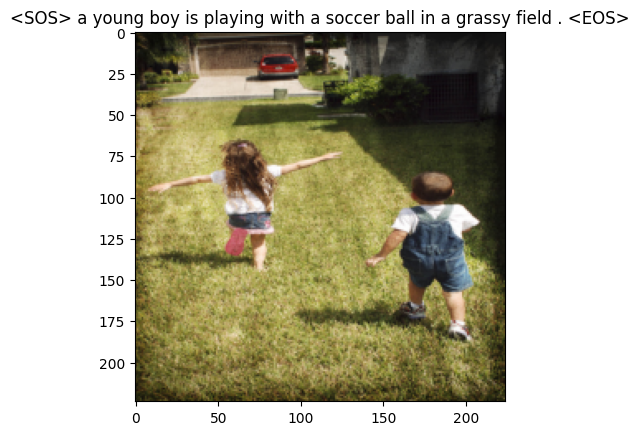

Epoch: 12 loss: 1.73688 iter:8000
features shape - torch.Size([1, 400])
<SOS> a dog runs through the grass . <EOS>


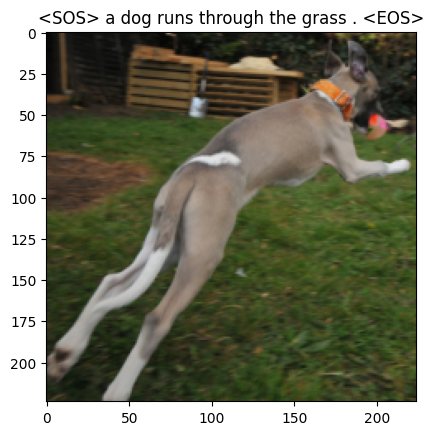

Epoch: 13 loss: 1.48936 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog is running through a river . <EOS>


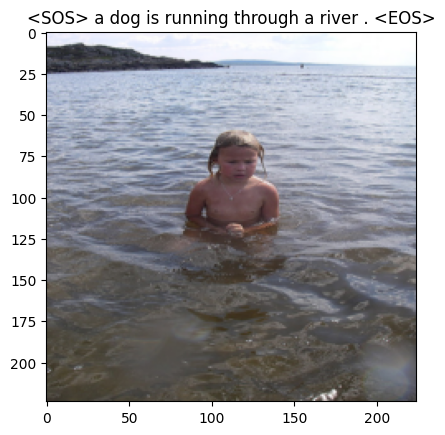

Epoch: 13 loss: 1.55421 iter:8000
features shape - torch.Size([1, 400])
<SOS> two brown dogs play in the water . <EOS>


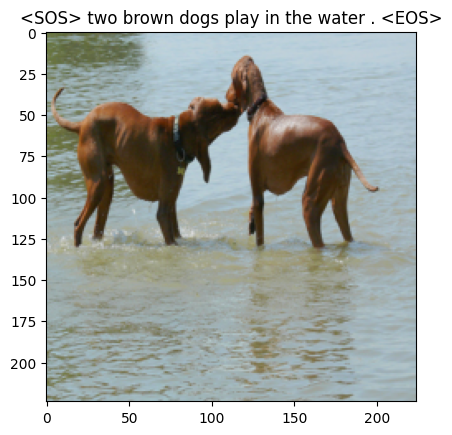

Epoch: 14 loss: 1.53933 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a black hat sits in front of a <UNK> wall . <EOS>


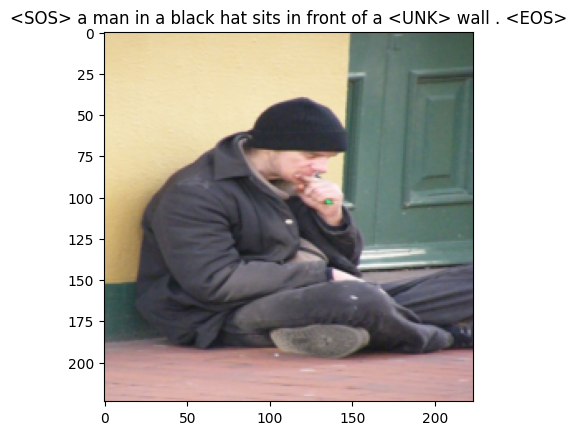

Epoch: 14 loss: 1.65153 iter:8000
features shape - torch.Size([1, 400])
<SOS> a soccer player in a white shirt is running with a football . <EOS>


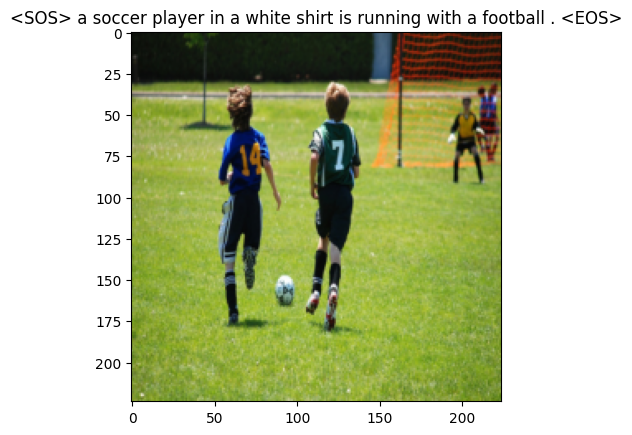

Epoch: 15 loss: 1.49473 iter:4000
features shape - torch.Size([1, 400])
<SOS> a brown dog is running through a grassy area . <EOS>


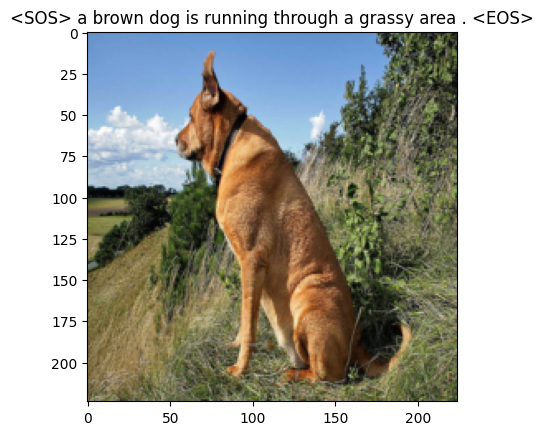

Epoch: 15 loss: 1.68207 iter:8000
features shape - torch.Size([1, 400])
<SOS> a crowd of people in front of a building with red and white flags . <EOS>


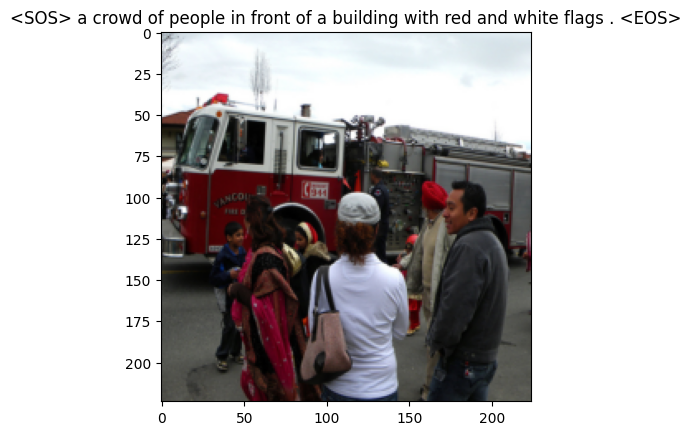

Epoch: 16 loss: 0.98976 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man is sitting on a bench next to his bike . <EOS>


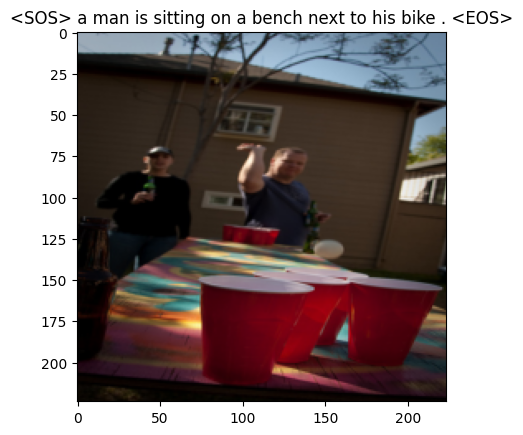

Epoch: 16 loss: 1.42002 iter:8000
features shape - torch.Size([1, 400])
<SOS> a black and white dog is running through a field . <EOS>


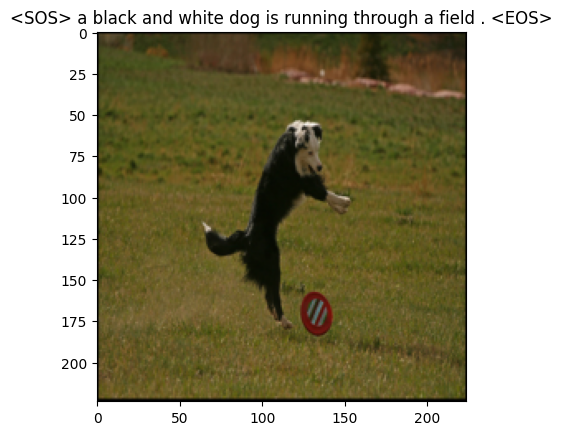

Epoch: 17 loss: 1.35313 iter:4000
features shape - torch.Size([1, 400])
<SOS> a girl in a bikini top is standing on a sandy beach . <EOS>


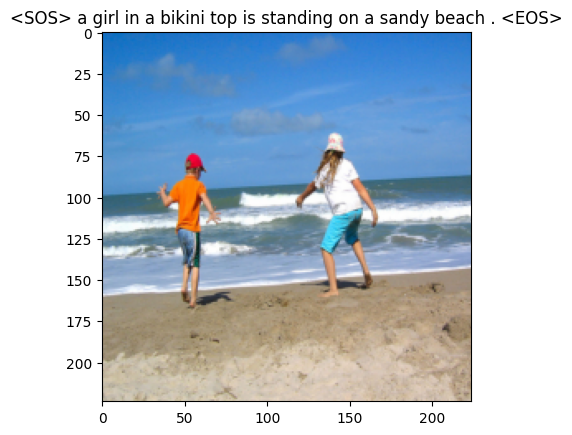

Epoch: 17 loss: 1.52396 iter:8000
features shape - torch.Size([1, 400])
<SOS> a brown and white dog is running through a snowy field . <EOS>


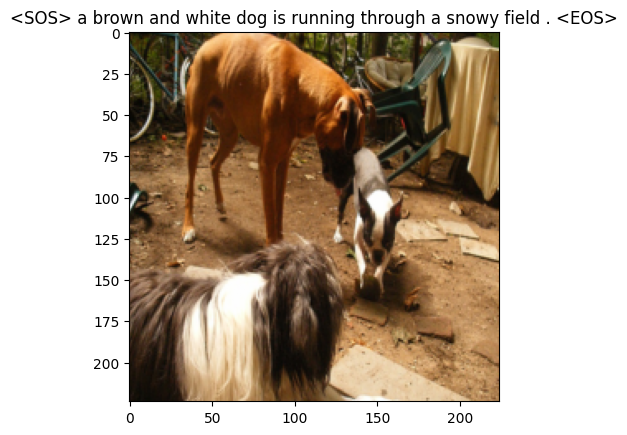

Epoch: 18 loss: 0.96831 iter:4000
features shape - torch.Size([1, 400])
<SOS> a group of dogs in the water . <EOS>


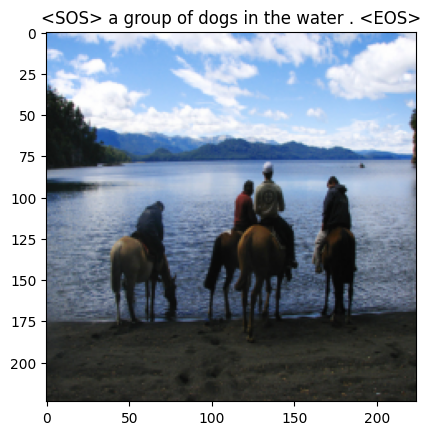

Epoch: 18 loss: 1.35000 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a blue shirt is on a black horse . <EOS>


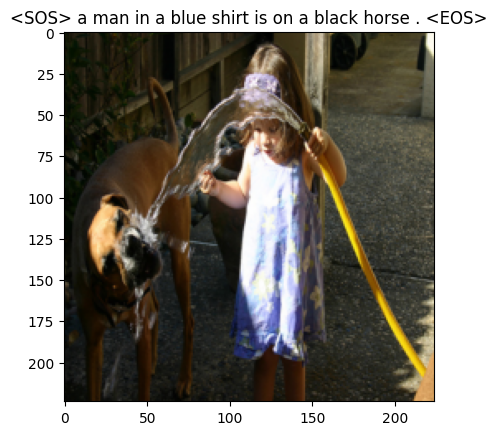

Epoch: 19 loss: 1.14891 iter:4000
features shape - torch.Size([1, 400])
<SOS> a woman with a baby in a white hat and sunglasses is talking to a man in a black


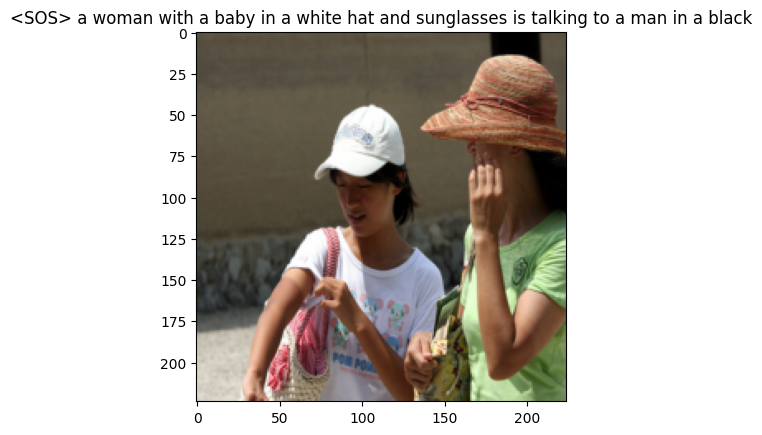

Epoch: 19 loss: 1.41073 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a black jacket is standing next to a <UNK> monument . <EOS>


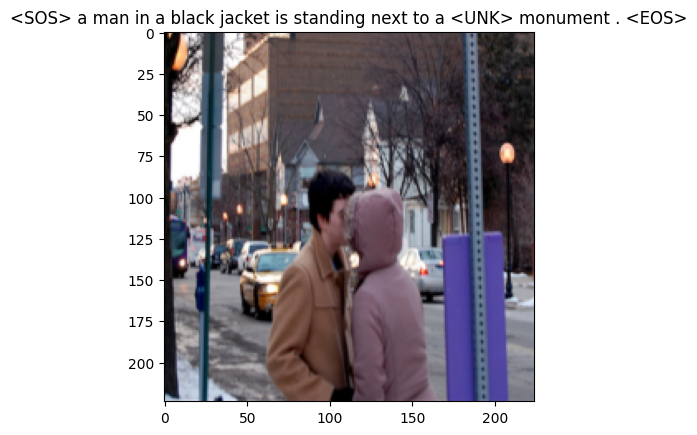

Epoch: 20 loss: 1.19444 iter:4000
features shape - torch.Size([1, 400])
<SOS> a woman in a black shirt and sunglasses is posing for a picture while holding onto a pole .


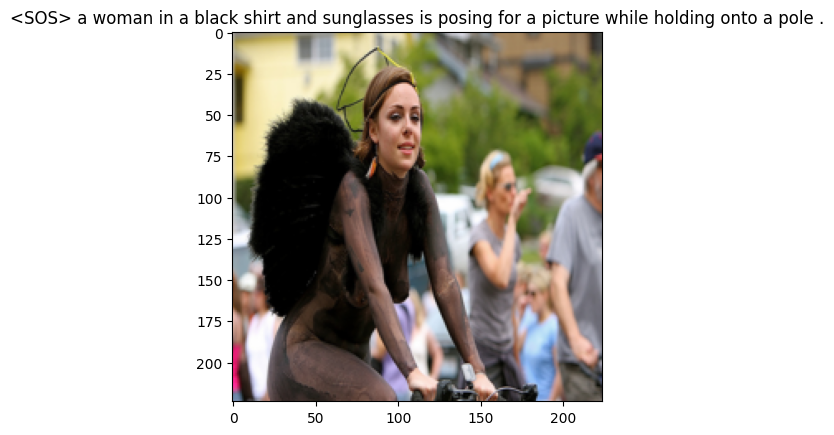

Epoch: 20 loss: 1.08308 iter:8000
features shape - torch.Size([1, 400])
<SOS> a dog is running through a field . <EOS>


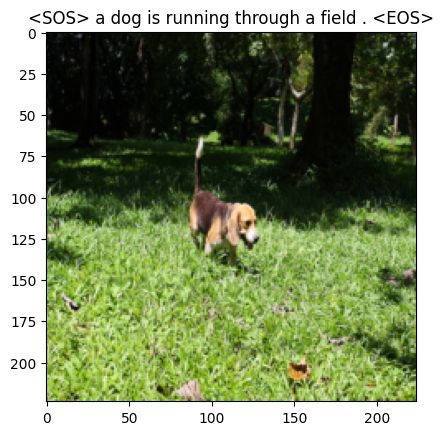

In [37]:
num_epochs = 20
print_every = 4000

for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in (enumerate(iter(data_loader))):
        image,captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs = model(image, captions)
        
        # Calculate the batch loss.
        loss = criterion(outputs.view(-1, vocab_size), captions.view(-1))

        
        # Backward pass.
        loss.backward()

        # Update the parameters in the optimizer.
        optimizer.step()

        writer.add_scalar("Training loss/epoch", loss.item(), epoch)
        
        if (idx+1)%print_every == 0:
            print("Epoch: {} loss: {:.5f} iter:{}".format(epoch,loss.item(),idx+1))

            
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img,_ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                print(f"features shape - {features.shape}")
                caps = model.decoder.generate_caption(features.unsqueeze(0),vocab=dataset.vocab)
                caption = ' '.join(caps)
                print(caption)
                show_image(img[0],title=caption)
                
            model.train()



In [38]:
%load_ext tensorboard
%tensorboard --logdir /content/resnet_gru --port 8088

<IPython.core.display.Javascript object>

Using the Tensorboard for Scalars and setting the horizontal axis as steps doesn't provides a good understanding of the model. However, by changing the horizonrtal axis to relative and/or to wall assists in better understanding of the model.

### While in other models, I used **"idx"**, ie the index for inner loop to see the loss curve for each epoch and the actual training, here I used **epochs**.

And by setting the horizontal axis as **step** we see the loses for all the 20 epochs as well. 

Thus, going relative and/or wall shows much better.

Another way to get the same thing but for step is to create a new variable steps that keeps on increasing by +1 at each cycle and simply, setting the `global_step = steps` before starting the training loop as follows:



```
writer.add_scalar("Training loss/epoch", loss.item(), global_step = steps)
steps+=1
```

steps is initialised before the outer epoch loop

# Testing the model

In this step we take a random image from the testing sample( size : 455), find its generated caption and then find the bleu-scores by comparing the original/human captions to the generated/predicted caption. 

In [39]:
import random
import pandas as pd
def testing():
  img_no = random.randrange(0,455,5)
  test_data_df = pd.read_csv(test_data_location)
  img_name = test_data_df['image'][img_no]
  original = test_data_df[test_data_df['image'] == img_name]['caption'].tolist()
  ref = []
  for i in original:
    ref.append([token.text.lower() for token in spacy_eng.tokenizer(i)])
  
  print('image_name : \t', img_name)
  print('original_captions: \t', original)
  print('references to be passed: \t', ref)
  model.eval()
  with torch.no_grad():
    img_location = os.path.join(image_data_location,img_name)
    img = Image.open(img_location).convert("RGB")
    transformed_image = transforms(img)
    show_image(transformed_image)
    features = model.encoder(transformed_image.unsqueeze(0).to(device))
    caps = model.decoder.generate_caption(features.unsqueeze(0), vocab = dataset.vocab)
    _1,_2,_3,_4 = bleu_score(ref, caps)
    return _1, _2, _3, _4


# Finding the bleu scores

In [42]:
from nltk.translate.bleu_score import SmoothingFunction
smoothie = SmoothingFunction().method4
def bleu_score(original_captions, generated_caption):
  #generated_caption.remove('<SOS>')
  #generated_caption.remove('<EOS>')
  print('BLEU Scores :')
  print('A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.')
  b_1 = sentence_bleu(original_captions, generated_caption, weights=(1.0, 0, 0, 0))
  b_2 = sentence_bleu(original_captions, generated_caption, weights=(0.5, 0.5, 0, 0))
  b_3 = sentence_bleu(original_captions, generated_caption, weights=(0.3, 0.3, 0.3, 0), smoothing_function  = smoothie)
  b_4 = sentence_bleu(original_captions, generated_caption, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function = smoothie)

  print("\ngenerated-caption : \t" , ' '.join(generated_caption))

  print('BLEU-1: %f' % b_1)
  print('BLEU-2: %f' % b_2)
  print('BLEU-3: %f' % b_3)
  print('BLEU-4: %f' % b_4)

  return b_1, b_2, b_3, b_4

# FInding the average bleu-scores of 10 random samples(images) from the testing data.


*****NEW_INPUT*******



image_name : 	 958326692_6210150354.jpg
original_captions: 	 ['A large tent with a green cover at a campground .', 'A tent and a campsite in a sunlit forest .', 'Picture of a campsite with a big green tent .', 'Rays of sunlight shine down on a green tent in the woods .', 'The sun is blazing through the trees onto a green tent in the woods .']
references to be passed: 	 [['a', 'large', 'tent', 'with', 'a', 'green', 'cover', 'at', 'a', 'campground', '.'], ['a', 'tent', 'and', 'a', 'campsite', 'in', 'a', 'sunlit', 'forest', '.'], ['picture', 'of', 'a', 'campsite', 'with', 'a', 'big', 'green', 'tent', '.'], ['rays', 'of', 'sunlight', 'shine', 'down', 'on', 'a', 'green', 'tent', 'in', 'the', 'woods', '.'], ['the', 'sun', 'is', 'blazing', 'through', 'the', 'trees', 'onto', 'a', 'green', 'tent', 'in', 'the', 'woods', '.']]


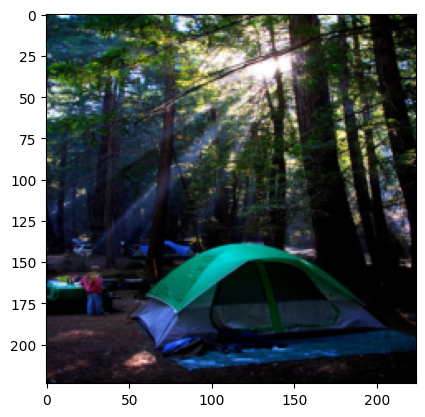

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a car is <UNK> off a dirt track in the woods <EOS>
BLEU-1: 0.461538
BLEU-2: 0.277350
BLEU-3: 0.225631
BLEU-4: 0.115727

*****NEW_INPUT*******



image_name : 	 965444691_fe7e85bf0e.jpg
original_captions: 	 ['A closeup of a man holding a baby wearing a blue shirt .', 'A man holds a chubby baby with pink cheeks and blue shirt .', 'A man in black holds a baby .', 'Ever since his baby girl started coming to the arcade with him , the dad enjoys watching others play his favorite pinball game .', 'The man is holding a baby near a carnival game .']
references to be passed: 	 [['a', 'closeup', 'of', 'a', 'man', 'holding', 'a', 'baby', 'wearing', 'a', 'blue', 'shirt', '.'], ['a', 'man', 'holds', 'a', 'chubby', 'baby', 'with', 'pink', 'cheeks', 'and', 'blue', 'shirt', '.'], ['a', 'man', 'in', 'black', 'holds', 'a', 'baby', '.'], ['ever', 'since', 'his', 'baby

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


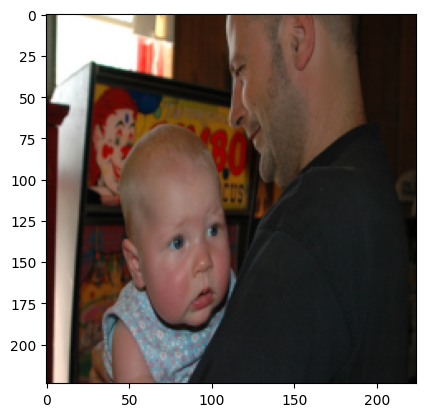

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a baby is sitting in a chair and holds a <UNK> . <EOS>
BLEU-1: 0.642857
BLEU-2: 0.314485
BLEU-3: 0.158943
BLEU-4: 0.071470

*****NEW_INPUT*******



image_name : 	 95734036_bef6d1a871.jpg
original_captions: 	 ['a biker bikes in the mountains .', 'A male bicyclist on a mountain road .', 'A man biking in front of mountains .', 'A man is biking down really rough terrain .', 'Man on bicycle trek high in the mountains .']
references to be passed: 	 [['a', 'biker', 'bikes', 'in', 'the', 'mountains', '.'], ['a', 'male', 'bicyclist', 'on', 'a', 'mountain', 'road', '.'], ['a', 'man', 'biking', 'in', 'front', 'of', 'mountains', '.'], ['a', 'man', 'is', 'biking', 'down', 'really', 'rough', 'terrain', '.'], ['man', 'on', 'bicycle', 'trek', 'high', 'in', 'the', 'mountains', '.']]


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


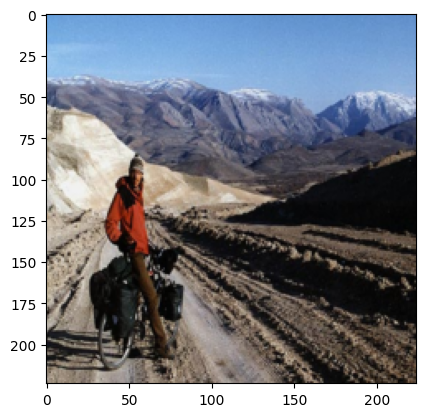

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a man is standing on top of a mountain . <EOS>
BLEU-1: 0.666667
BLEU-2: 0.426401
BLEU-3: 0.300532
BLEU-4: 0.149684

*****NEW_INPUT*******



image_name : 	 946051430_8db7e4ce09.jpg
original_captions: 	 ['girls in swimsuits jumping into water from behind', 'A group of five women and girls in bathing suits jumps into the water with their backs to the camera .', 'Five girls in swimsuits , are seen from the back , jumping into the water .', 'Girls in swimsuits , holding hands and leaping into water .', 'The five girls wearing swimsuits jump into the water .']
references to be passed: 	 [['girls', 'in', 'swimsuits', 'jumping', 'into', 'water', 'from', 'behind'], ['a', 'group', 'of', 'five', 'women', 'and', 'girls', 'in', 'bathing', 'suits', 'jumps', 'into', 'the', 'water', 'with', 'their', 'backs', 'to', 'the', 'camera', '.'], ['five', 'girls', 'in', 's

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


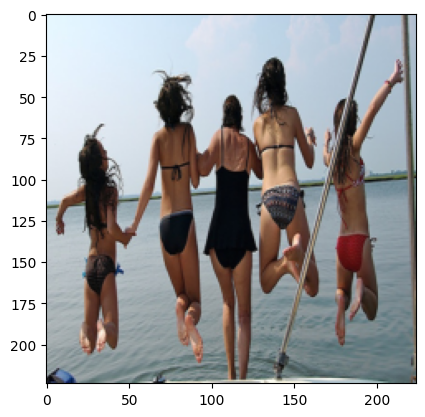

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> four girls jump up while standing in a shallow pool . <EOS>
BLEU-1: 0.384615
BLEU-2: 0.000000
BLEU-3: 0.062298
BLEU-4: 0.027999

*****NEW_INPUT*******



image_name : 	 989754491_7e53fb4586.jpg
original_captions: 	 ['A girl in a pool wearing goggles and surrounded by other children', 'A girl in green goggles in a pool with three other children .', 'A red haired girl making a peace sign is wearing neon green glasses and floaties and playing in the pool with other kids .', 'A red-headed girl offers the peace sign as she swims in the pool with floaties .', 'A young girl with goggles and floaties poses for the camera as she plays in a pool .']
references to be passed: 	 [['a', 'girl', 'in', 'a', 'pool', 'wearing', 'goggles', 'and', 'surrounded', 'by', 'other', 'children'], ['a', 'girl', 'in', 'green', 'goggles', 'in', 'a', 'pool', 'with', 'three', 'oth

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

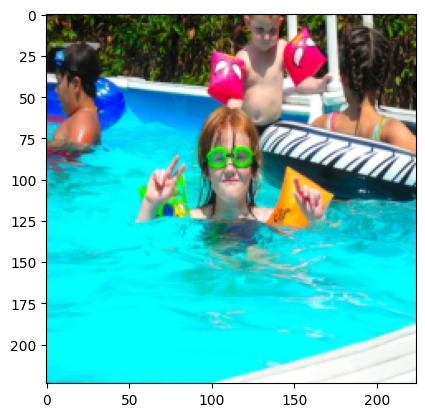

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a girl in a pool <UNK> her hair splash . <EOS>
BLEU-1: 0.500000
BLEU-2: 0.426401
BLEU-3: 0.417857
BLEU-4: 0.331808

*****NEW_INPUT*******



image_name : 	 927420680_6cba7c040a.jpg
original_captions: 	 ['A man is walking by trees in front of the city skyline .', 'a man walking next to an extremely large tree trunk', 'An old man is walking next to big , tall trees .', 'Someone in a light shirt is walking past several large trees overlooking a city .', 'The man walks among the large trees .']
references to be passed: 	 [['a', 'man', 'is', 'walking', 'by', 'trees', 'in', 'front', 'of', 'the', 'city', 'skyline', '.'], ['a', 'man', 'walking', 'next', 'to', 'an', 'extremely', 'large', 'tree', 'trunk'], ['an', 'old', 'man', 'is', 'walking', 'next', 'to', 'big', ',', 'tall', 'trees', '.'], ['someone', 'in', 'a', 'light', 'shirt', 'is', 'walking', 'past', '

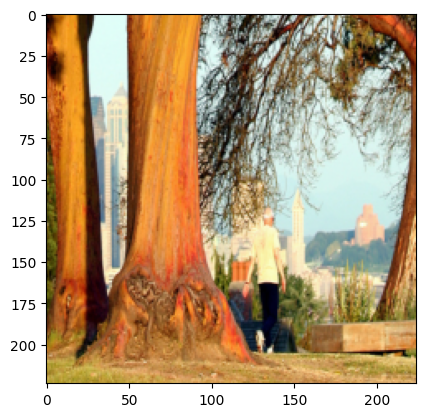

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a group of people sit on a bench , with trees in the background . <EOS>
BLEU-1: 0.470588
BLEU-2: 0.171499
BLEU-3: 0.105539
BLEU-4: 0.048692

*****NEW_INPUT*******



image_name : 	 95783195_e1ba3f57ca.jpg
original_captions: 	 ['A hiker navigates a rope and wood bridge over a large dry ravine .', 'A person with a shoulder bag is walking across a shaky wooden slat bridge .', 'a woman crossing a wooden link wire bridge', 'A woman walking across an old rope and driftrood bridge between mountains .', 'The woman is walking on a rickety narrow bridge .']
references to be passed: 	 [['a', 'hiker', 'navigates', 'a', 'rope', 'and', 'wood', 'bridge', 'over', 'a', 'large', 'dry', 'ravine', '.'], ['a', 'person', 'with', 'a', 'shoulder', 'bag', 'is', 'walking', 'across', 'a', 'shaky', 'wooden', 'slat', 'bridge', '.'], ['a', 'woman', 'crossing', 'a', 'wooden', 'l

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


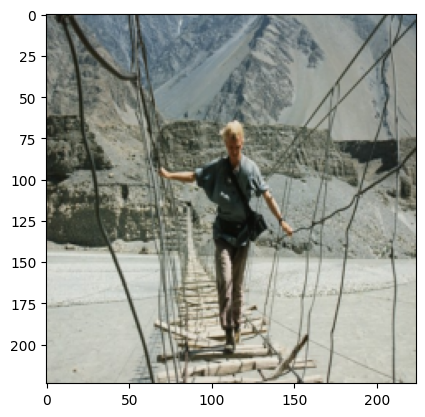

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a skier on a slope . <EOS>
BLEU-1: 0.500000
BLEU-2: 0.267261
BLEU-3: 0.165234
BLEU-4: 0.084704

*****NEW_INPUT*******



image_name : 	 94232465_a135df2711.jpg
original_captions: 	 ['A lady ice skates while pulling a child in a buggy .', 'A mother pulls her daughter in a wagon over a snowy plain .', 'A woman pulling a wagon with a girl in it across a frozen lake', 'The girl pulls a toddler in a cart while skating on the ice .', 'The woman is ice skating and pulling the little girl in the cart across the ice .']
references to be passed: 	 [['a', 'lady', 'ice', 'skates', 'while', 'pulling', 'a', 'child', 'in', 'a', 'buggy', '.'], ['a', 'mother', 'pulls', 'her', 'daughter', 'in', 'a', 'wagon', 'over', 'a', 'snowy', 'plain', '.'], ['a', 'woman', 'pulling', 'a', 'wagon', 'with', 'a', 'girl', 'in', 'it', 'across', 'a', 'frozen', 'lake'], ['the', 'girl', 

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


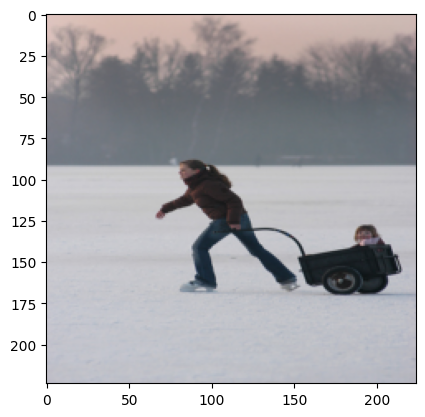

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a man in a red jacket and hat is snowboarding . <EOS>
BLEU-1: 0.461538
BLEU-2: 0.196116
BLEU-3: 0.121847
BLEU-4: 0.058236

*****NEW_INPUT*******



image_name : 	 888517718_3d5b4b7b43.jpg
original_captions: 	 ['A brown and black dog is standing on its hind legs trying to catch something .', 'A dog is jumping up on hind legs with its mouth open .', 'A dog plays on the grass .', 'A German shepherd playing with water in the grass .', 'German Shepherd standing up snapping at droplets of water']
references to be passed: 	 [['a', 'brown', 'and', 'black', 'dog', 'is', 'standing', 'on', 'its', 'hind', 'legs', 'trying', 'to', 'catch', 'something', '.'], ['a', 'dog', 'is', 'jumping', 'up', 'on', 'hind', 'legs', 'with', 'its', 'mouth', 'open', '.'], ['a', 'dog', 'plays', 'on', 'the', 'grass', '.'], ['a', 'german', 'shepherd', 'playing', 'with', 'water', 'in',

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


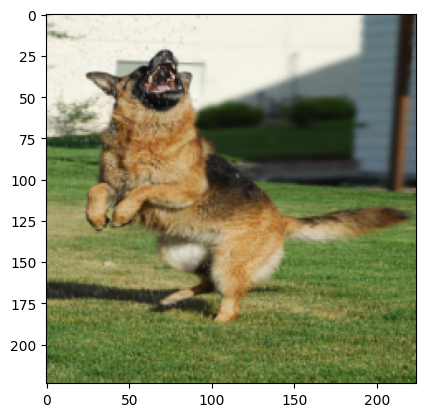

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a dog with a frisbee in its mouth , jumps over a man . <EOS>
BLEU-1: 0.437500
BLEU-2: 0.241523
BLEU-3: 0.131463
BLEU-4: 0.059244

*****NEW_INPUT*******



image_name : 	 95728660_d47de66544.jpg
original_captions: 	 ['A guy is riding a bike up the side of a hill .', 'A young man bicycles towards the camera and away from beautiful mountains on a clear day .', 'Man on bike in mountains', 'Man riding a bicycle down a narrow path .', 'man riding bike on trail']
references to be passed: 	 [['a', 'guy', 'is', 'riding', 'a', 'bike', 'up', 'the', 'side', 'of', 'a', 'hill', '.'], ['a', 'young', 'man', 'bicycles', 'towards', 'the', 'camera', 'and', 'away', 'from', 'beautiful', 'mountains', 'on', 'a', 'clear', 'day', '.'], ['man', 'on', 'bike', 'in', 'mountains'], ['man', 'riding', 'a', 'bicycle', 'down', 'a', 'narrow', 'path', '.'], ['man', 'riding', 'bike', 

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


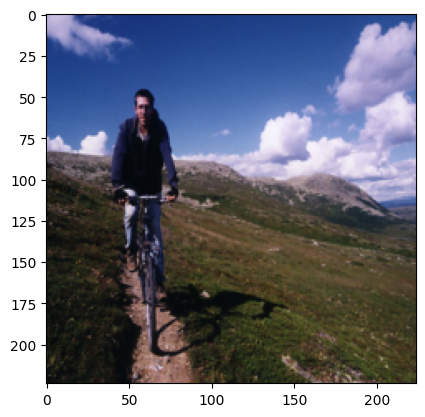

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 <SOS> a man is standing on top of a mountain . <EOS>
BLEU-1: 0.536693
BLEU-2: 0.211871
BLEU-3: 0.125823
BLEU-4: 0.060086

****FINDING AVERAGE SCORES****

Average_BLEU-1_score_for_the_above_printed_images: 0.506200
Average_BLEU-2_score_for_the_above_printed_images: 0.253291
Average_BLEU-3_score_for_the_above_printed_images: 0.181517
Average_BLEU-4_score_for_the_above_printed_images: 0.100765


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


In [46]:
b_1 = []
b_2 = []
b_3 = []
b_4 = []
for i in range(10):
  print('\n*****NEW_INPUT*******\n')
  print('\n')
  _1, _2, _3, _4 = testing()
  b_1.append(_1)
  b_2.append(_2)
  b_3.append(_3)
  b_4.append(_4)

print('\n****FINDING AVERAGE SCORES****\n')
from statistics import mean
print('Average_BLEU-1_score_for_the_above_printed_images: %f' % mean(b_1))
print('Average_BLEU-2_score_for_the_above_printed_images: %f' % mean(b_2))
print('Average_BLEU-3_score_for_the_above_printed_images: %f' % mean(b_3))
print('Average_BLEU-4_score_for_the_above_printed_images: %f' % mean(b_4))

**FROM THE ABOVE WE CAN CLEARLY UNDERSTAND ON THING :**

***THE MODEL IS PRIORITISING SINGLE WORDS OVER A COMPLETED AND BETTER SENTENCE***

THIS IS DUE TO **`argmax`** function used while generating captions.


*As can be seen from above the average values of bleu_scores. These values indicate that 1-gram bleu-score is better while 4-gram bleu score is not good. This attributes to the above stated fact that the model is preferring individual words over the complete sentences. This could potentially be solved somewhat by using beam-search based prediction method and utilizing attention layers.*

However, the key point to notice here is that the average is calculated by randomly choosing only 10 images. These Average scores can potentially increase/dexrease by taking a bigger sample or just by rerunning the testing the above loop.

However, an easier way to do is to increase the number of training epochs. One can try to train their own individual model by taking these as a starting point to further train models for more epochs and/or try beam-search based prediction techniques.  